# Refine tangram annotations using clustering for cervix_s0

In [1]:
slide_id = "cervix_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_{slide_id}.zarr")
sdata

SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_cervix_s0.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 46545, 38219), (3, 23273, 19110)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 13) (3D points)
├── Shapes
│     └── 'nucleus_boundaries': GeoDataFrame shape: (825663, 1) (2D shapes)
└── Tables
      └── 'table': AnnData (825663, 8180)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), nucleus_boundaries (Shapes)

In [4]:
adata_ini = sdata.table.copy()
adata_ini

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_3020/823217089.py:1: DeprecationWarning: Table accessor will be deprecated with SpatialData version 0.1, use sdata.tables instead.
  adata_ini = sdata.table.copy()


AnnData object with n_obs × n_vars = 825663 × 8180
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram'
    uns: 'sopa_attrs', 'spatialdata_attrs'
    obsm: 'spatial', 'tangram_pred'

In [5]:
adata_ini.obs

,region,slide,cell_id,area,ct_tangram
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,50.213408,Plasma cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,14.382159,MMP19 macrophage
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,16.571872,CXCL13 exhausted CD8 T
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,36.304979,Naive CD4 T cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,25.152272,Ovarian cancer specific LGR5 MUC16 epithelial ...
...,...,...,...,...,...
aaamjjdk-1,nucleus_boundaries,morpho,aaamjjdk-1,14.563144,Pericyte
aaamjjdl-1,nucleus_boundaries,morpho,aaamjjdl-1,4.808903,Pericyte
aaamjjdm-1,nucleus_boundaries,morpho,aaamjjdm-1,15.127435,pDC
aaamjjdn-1,nucleus_boundaries,morpho,aaamjjdn-1,8.625107,CD56 NK


In [6]:
adata_ini.var

""
A2ML1
AAMP
AAR2
AARSD1
ABAT
...
ZSCAN26
ZSWIM6
ZUP1
ZYG11B


## 2. Preprocessing

In [7]:
# Add transcripts counts
adata_ini.obs["transcript_counts"] = adata_ini.X.sum(axis=1)
adata_ini.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,50.213408,Plasma cell,119
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,14.382159,MMP19 macrophage,35
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,16.571872,CXCL13 exhausted CD8 T,54
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,36.304979,Naive CD4 T cell,120
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,25.152272,Ovarian cancer specific LGR5 MUC16 epithelial ...,104
...,...,...,...,...,...,...
aaamjjdk-1,nucleus_boundaries,morpho,aaamjjdk-1,14.563144,Pericyte,22
aaamjjdl-1,nucleus_boundaries,morpho,aaamjjdl-1,4.808903,Pericyte,3
aaamjjdm-1,nucleus_boundaries,morpho,aaamjjdm-1,15.127435,pDC,11
aaamjjdn-1,nucleus_boundaries,morpho,aaamjjdn-1,8.625107,CD56 NK,9


<Axes: >

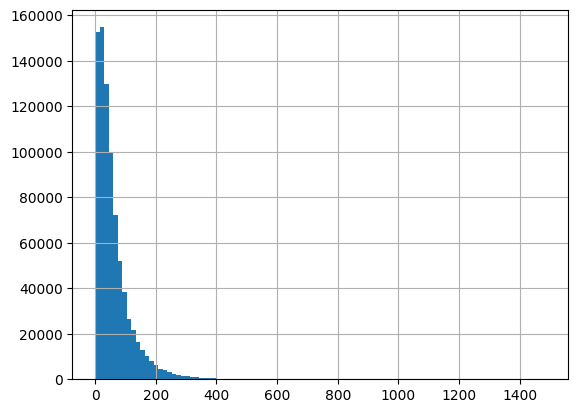

In [8]:
adata_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

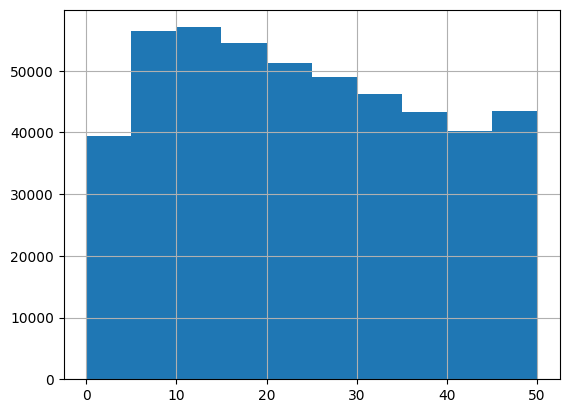

In [9]:
# in range 0-50
adata_ini.obs['transcript_counts'].hist(range=(0,50))

In [10]:
print(f"Number of cells with less than 20 transcripts: {(adata_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_ini.obs['transcript_counts']<20).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_ini.obs['transcript_counts']<15).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_ini.obs['transcript_counts']<10).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_ini.obs)}")

Number of cells with less than 20 transcripts: 207364
Percentage of cells with less than 20 transcripts: 25.11%
-----
Number of cells with less than 15 transcripts: 152837
Percentage of cells with less than 15 transcripts: 18.51%
-----
Number of cells with less than 10 transcripts: 95783
Percentage of cells with less than 10 transcripts: 11.6%
-----
Number total of cells: 825663


In [11]:
adata =  adata_ini[adata_ini.obs['transcript_counts']>10].copy()
print(len(adata.obs))

718435


In [12]:
# Save and do clustering on ruche using gpu
adata.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_att/adata_for_gpu_clustering_{slide_id}.h5ad")

In [12]:
# # Save the raw data
# adata.layers['count'] = adata.X.copy()

In [13]:
# # Normalize
# sc.pp.normalize_total(adata, target_sum=1e4)
# sc.pp.log1p(adata)
# adata.layers['log_norm'] = adata.X.copy()

In [14]:
# # Scale each gene to unit variance. Clip values exceeding standard deviation 10.
# sc.pp.scale(adata, max_value=10)

## 3. Principal component analysis

In [ ]:
# # Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
# sc.tl.pca(adata, svd_solver="arpack", use_highly_variable=False)

In [ ]:
# # Contribution of single PCs to the total variance in the data
# # This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
# sc.pl.pca_variance_ratio(adata, log=True)

In [ ]:
# adata

In [20]:
# # Restore X to be log norm counts
# # /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
# dc.swap_layer(adata, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [ ]:
# # Neighborhood graph of cells using the PCA representation of the data matrix
# sc.pp.neighbors(adata, n_neighbors=20, n_pcs=16, use_rep="X_pca", key_added='pca_n20_pcs16')
# # Embedding the neighborhood graph using UMAP
# sc.tl.umap(adata, neighbors_key='pca_n20_pcs16', min_dist=0.6)
# # Leiden clustering directly clusters the neighborhood graph of cells
# sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=-1, directed=False, key_added='pca_n20_pcs16_leiden_res0.2', neighbors_key='pca_n20_pcs16')
# sc.tl.leiden(adata, resolution=0.4, random_state=0, n_iterations=-1, directed=False, key_added='pca_n20_pcs16_leiden_res0.4', neighbors_key='pca_n20_pcs16')
# sc.tl.leiden(adata, resolution=0.6, random_state=0, n_iterations=-1, directed=False, key_added='pca_n20_pcs16_leiden_res0.6', neighbors_key='pca_n20_pcs16')

In [3]:
# reload adata after clustring on ruche
adata = sc.read_h5ad(f"/Users/felicie-giraud-sauveur/Documents/HE2CellType/code/CT_DS/data/adata_after_gpu_clustering_{slide_id}.h5ad")

In [4]:
adata

AnnData object with n_obs × n_vars = 718435 × 8180
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6'
    var: 'mean', 'std'
    uns: 'leiden', 'log1p', 'pca', 'pca_n20_pcs16', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n20_pcs16_connectivities', 'pca_n20_pcs16_distances'

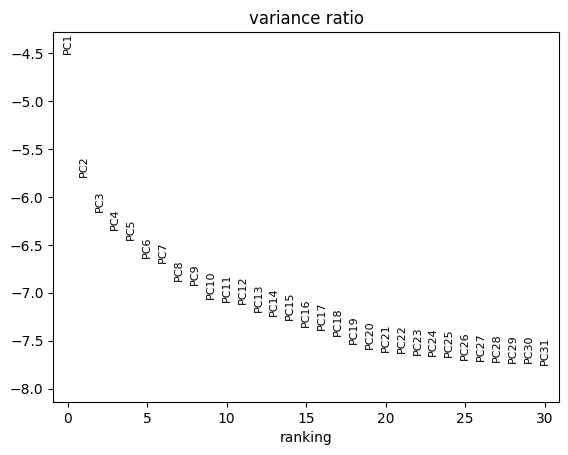

In [5]:
sc.pl.pca_variance_ratio(adata, log=True)

In [6]:
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
print(f"Sum count: {adata.layers['count'].sum()}")
print(f"Sum log_norm: {adata.layers['log_norm'].sum()}")
print(f"Sum X: {adata.X.sum()}")

Sum count: 47840512.0
Sum log_norm: 168972960.0
Sum X: 168972960.0


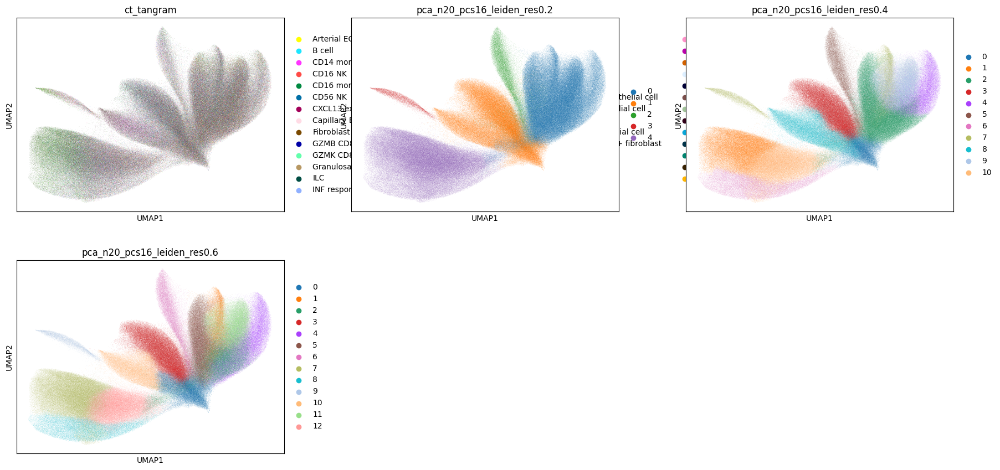

In [7]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n20_pcs16',
           color=['ct_tangram', 'pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6'],
           ncols=3)

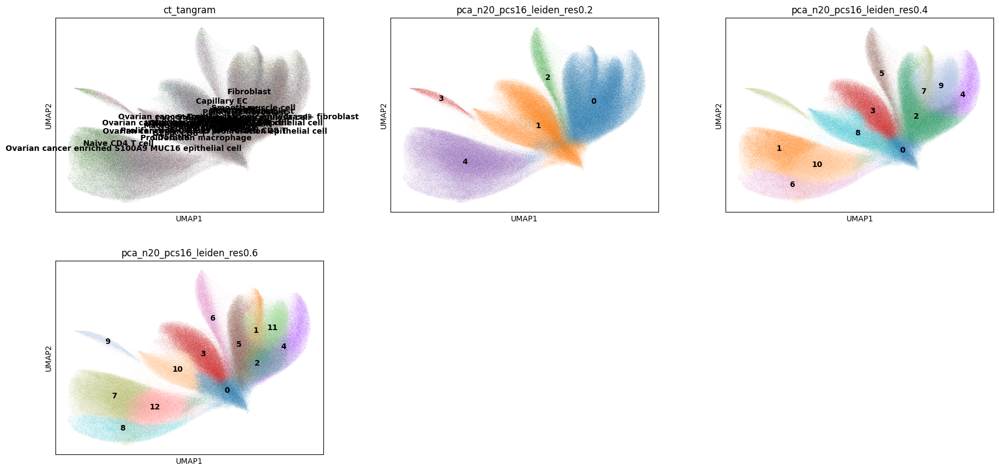

In [8]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n20_pcs16',
           color=['ct_tangram', 'pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

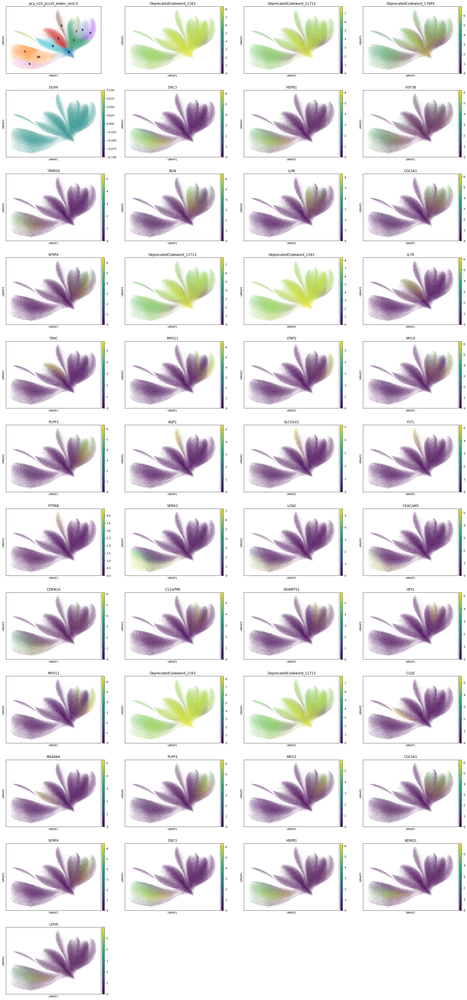

In [9]:
clustering_label = 'pca_n20_pcs16_leiden_res0.4'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [10]:
# Number of clusters
adata.obs['pca_n20_pcs16_leiden_res0.6'].unique()

['9', '10', '3', '7', '12', ..., '4', '5', '6', '2', '1']
Length: 13
Categories (13, object): ['0', '1', '2', '3', ..., '9', '10', '11', '12']

In [11]:
# Refine resolution
adata.obs['refine_res'] = 'att'

adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['0']), 'refine_res'] = '0'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['1']), 'refine_res'] = '1'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['2']), 'refine_res'] = '2'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['3']), 'refine_res'] = '3'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['4']), 'refine_res'] = '4'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['6']), 'refine_res'] = '6'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['7']), 'refine_res'] = '7'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '8'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['9']), 'refine_res'] = '9'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['10']), 'refine_res'] = '10'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['11']), 'refine_res'] = '11'
adata.obs.loc[adata.obs['pca_n20_pcs16_leiden_res0.6'].isin(['12']), 'refine_res'] = '12'

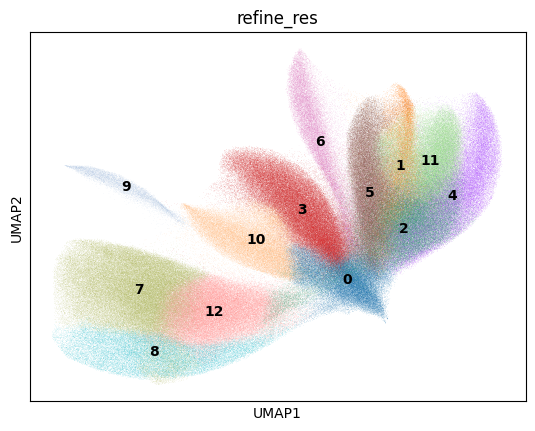

In [12]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n20_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [13]:
clustering_label = 'refine_res'

In [14]:
def get_top_tangram_labels_for_clustering(adata, clustering_key, top_n=3):

    grouped = adata.obs.groupby(clustering_key)
    results = []
    
    for cluster, group in grouped:
        
        label_counts = Counter(group['ct_tangram'])
        total_cells = len(group)
        label_percentages = [(label, round(count / total_cells * 100)) for label, count in label_counts.items()]
        top_labels = sorted(label_percentages, key=lambda x: x[1], reverse=True)[:top_n]
        
        for label, percentage in top_labels:
            results.append({
                'Cluster': cluster,
                'Label': label,
                'Percentage': percentage
            })
    
    cluster_df = pd.DataFrame(results)
    
    return cluster_df

top_tangram = get_top_tangram_labels_for_clustering(adata, clustering_label, top_n=7)

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_5066/3112203278.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = adata.obs.groupby(clustering_key)


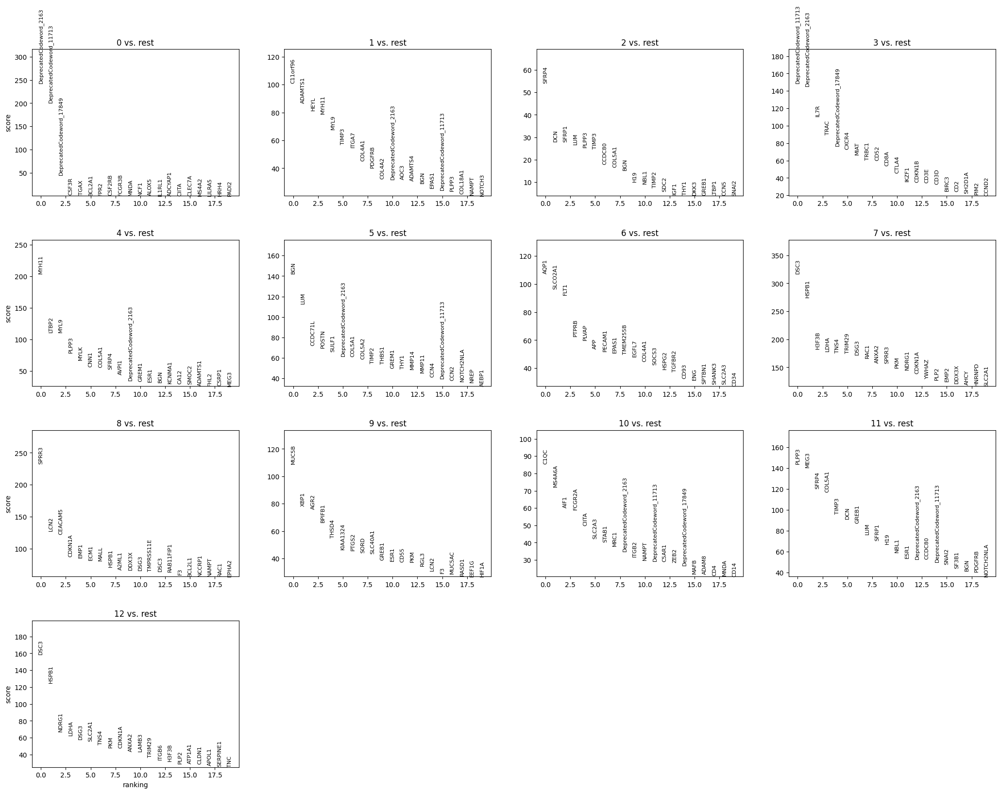

In [15]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [16]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [17]:
adata.obs['label1'] = 'att'
adata.obs['label2'] = 'att'
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

### 5.1. Cluster 0

In [18]:
cluster_id = '0'

In [19]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
0,0,pDC,5
1,0,B cell,4
2,0,cDC2,4
3,0,CD14 monocyte,4
4,0,cDC1,4
5,0,Macrophage,4
6,0,Proliferation macrophage,3


In [20]:
top_ranked_genes[cluster_id]

0     DeprecatedCodeword_2163
1    DeprecatedCodeword_11713
2    DeprecatedCodeword_17849
3                       CSF3R
4                       ITGAX
5                      BCL2A1
6                        FPR2
Name: 0, dtype: object

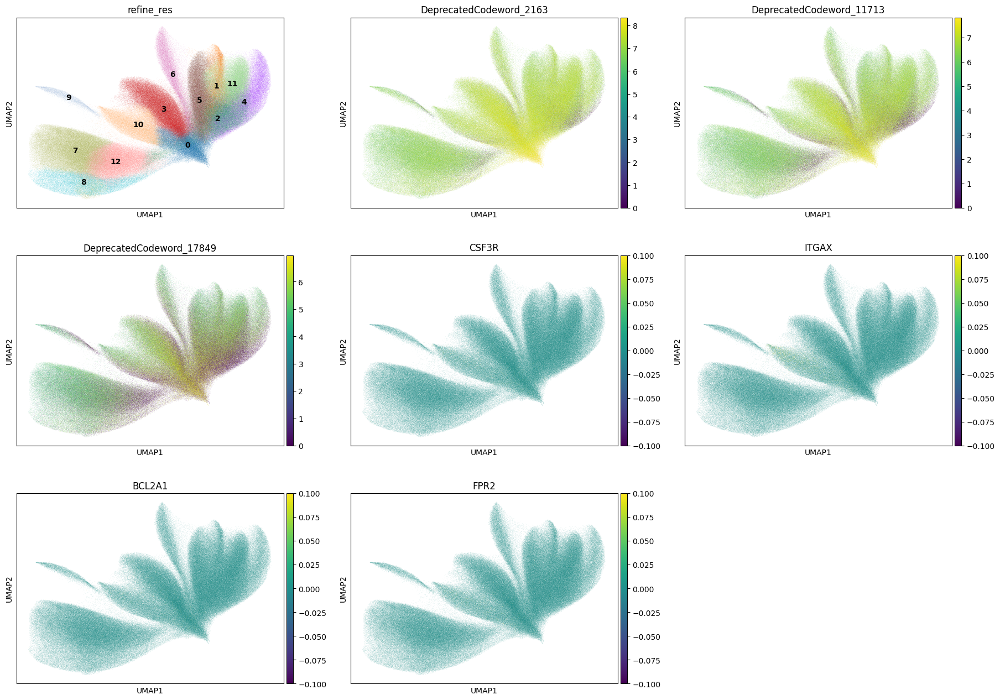

In [21]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [22]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 51320
Percentage of cells in cluster 0: 7.1


In [23]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Unknown'

### 5.2. Cluster 1

In [24]:
cluster_id = '1'

In [25]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
7,1,Smooth muscle cell,8
8,1,Pericyte,6
9,1,Fibroblast,5
10,1,Ovarian cancer specific LGR5 MUC16 epithelial ...,4
11,1,ILC,3
12,1,CD56 NK,3
13,1,CD14 monocyte,3


In [26]:
top_ranked_genes[cluster_id]

0    C11orf96
1     ADAMTS1
2        HEYL
3       MYH11
4        MYL9
5       TIMP3
6       ITGA7
Name: 1, dtype: object

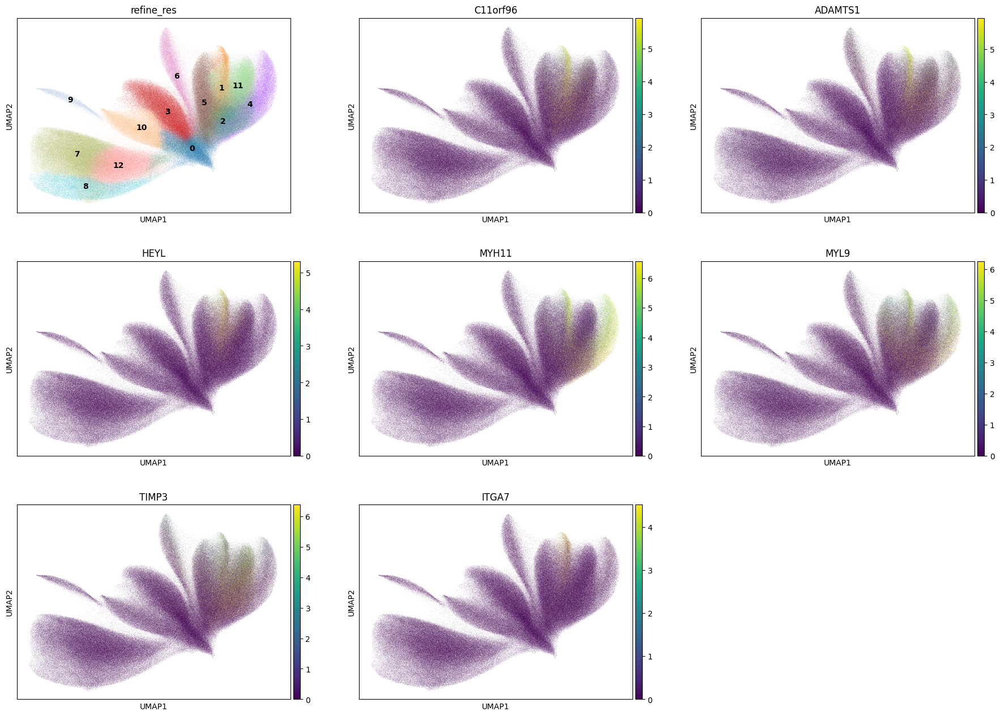

In [27]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [28]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 26490
Percentage of cells in cluster 1: 3.7


In [29]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Smooth_muscle'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Smooth_muscle'

### 5.3. Cluster 2

In [30]:
cluster_id = '2'

In [31]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
14,2,Granulosa cell,5
15,2,Fibroblast,4
16,2,pDC,4
17,2,Pericyte,4
18,2,PLA2G2A fibroblast,4
19,2,Ovarian cancer specific LGR5 MUC16 epithelial ...,3
20,2,mregDC,3


In [32]:
top_ranked_genes[cluster_id]

0     SFRP4
1       DCN
2     SFRP1
3       LUM
4     PLPP3
5     TIMP3
6    CCDC80
Name: 2, dtype: object

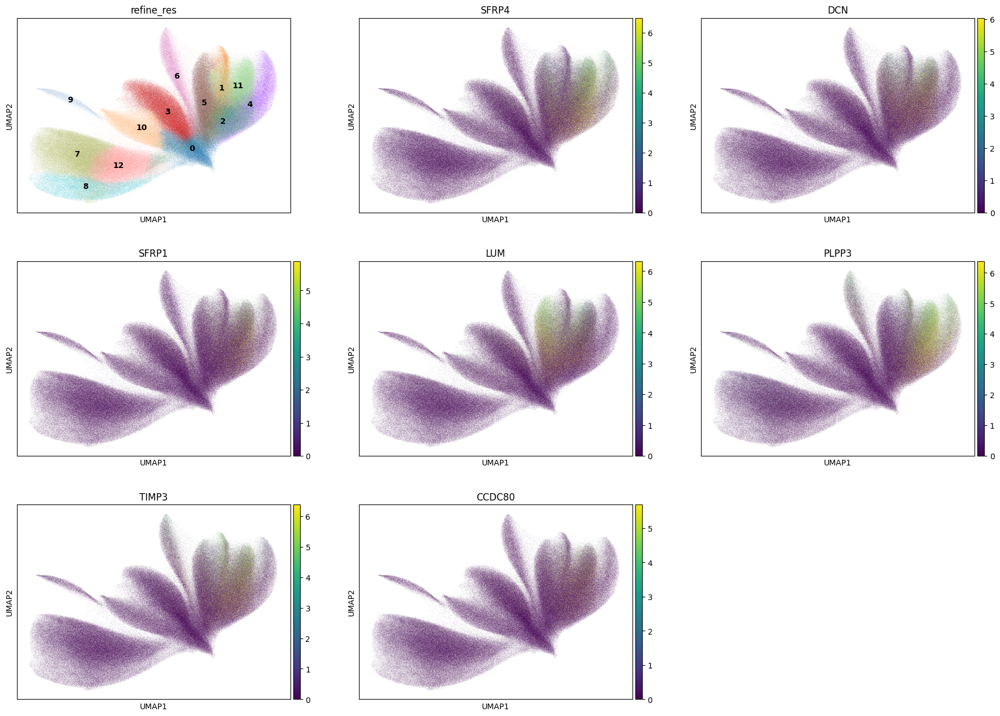

In [33]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [35]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 64493
Percentage of cells in cluster 2: 9.0


In [36]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Unknown'

### 5.4. Cluster 3

In [37]:
cluster_id = '3'

In [38]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
21,3,Treg,9
22,3,Naive CD4 T cell,6
23,3,GZMK CD8 T,5
24,3,Plasma cell,5
25,3,B cell,5
26,3,CXCL13 exhausted CD8 T,4
27,3,INF responsed CD8 T,4


In [39]:
top_ranked_genes[cluster_id]

0    DeprecatedCodeword_11713
1     DeprecatedCodeword_2163
2                        IL7R
3                        TRAC
4    DeprecatedCodeword_17849
5                       CXCR4
6                        MIAT
Name: 3, dtype: object

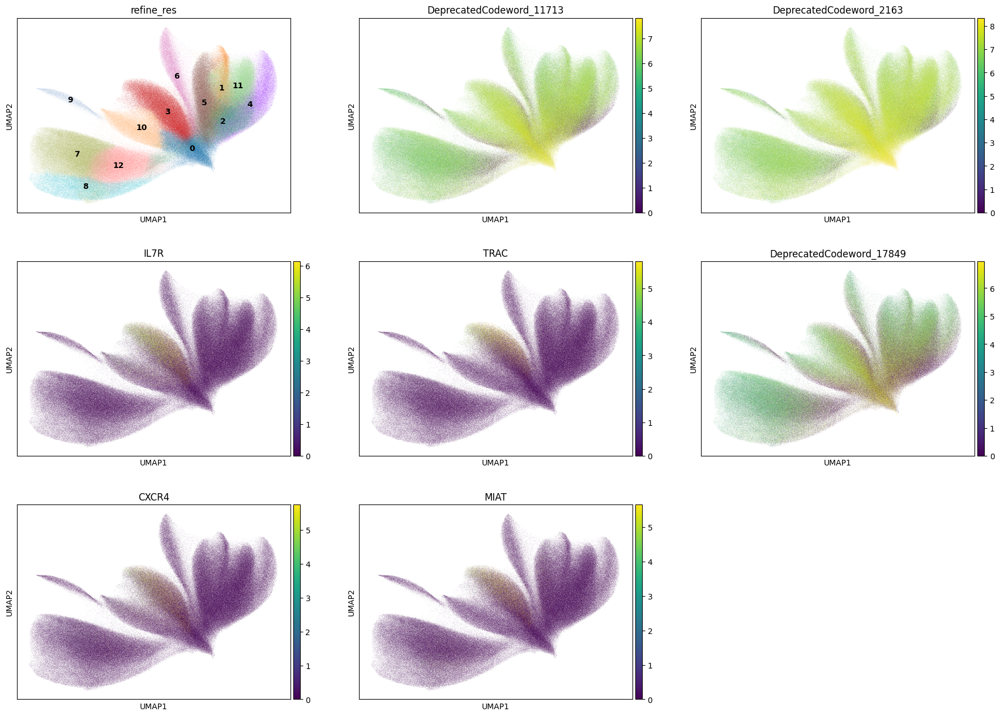

In [40]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [41]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 96054
Percentage of cells in cluster 3: 13.4


In [42]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.5. Cluster 4

In [43]:
cluster_id = '4'

In [44]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
28,4,Fibroblast,7
29,4,Ovarian cancer specific LGR5 MUC16 epithelial ...,5
30,4,PLA2G2A fibroblast,4
31,4,Pericyte,4
32,4,Smooth muscle cell,3
33,4,CD56 NK,3
34,4,Ovarian cancer enriched S100A9 MUC16 epithelia...,3


In [45]:
top_ranked_genes[cluster_id]

0     MYH11
1     LTBP2
2      MYL9
3     PLPP3
4      MYLK
5      CNN1
6    COL5A1
Name: 4, dtype: object

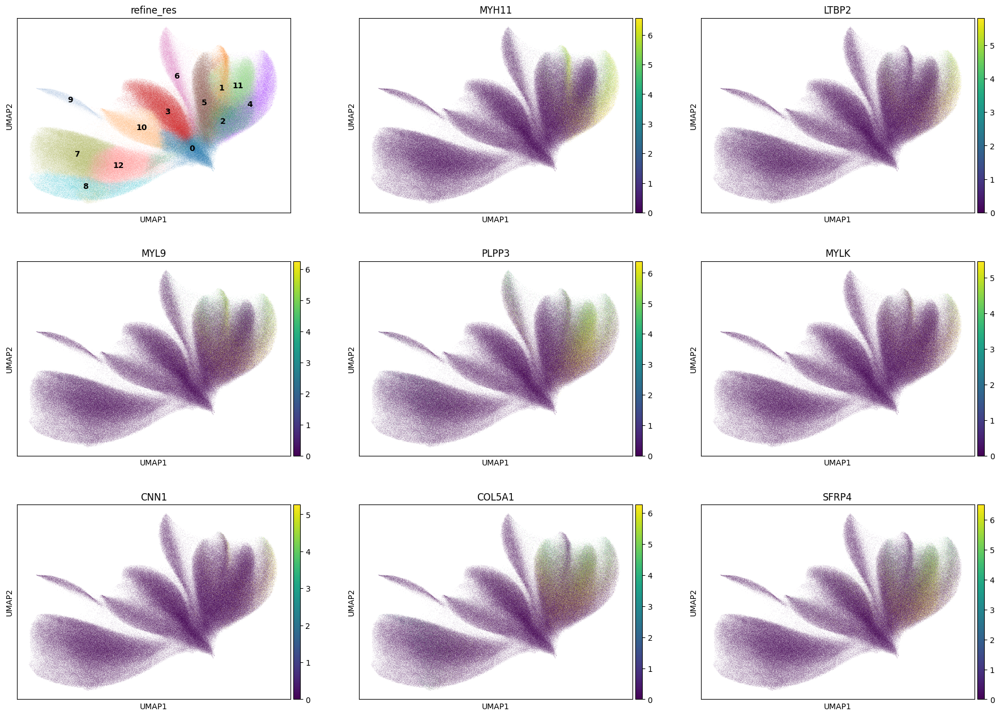

In [48]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7]+['SFRP4'], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [47]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 56279
Percentage of cells in cluster 4: 7.8


In [49]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Smooth_muscle'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Smooth_muscle'

### 5.6. Cluster 5

In [50]:
cluster_id = '5'

In [51]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
35,5,Fibroblast,8
36,5,Ovarian cancer specific LGR5 MUC16 epithelial ...,4
37,5,Treg,3
38,5,B cell,3
39,5,CD14 monocyte,3
40,5,Naive CD4 T cell,3
41,5,ILC,3


In [52]:
top_ranked_genes[cluster_id]

0                        BGN
1                        LUM
2                    CCDC71L
3                      POSTN
4                      SULF1
5    DeprecatedCodeword_2163
6                     COL5A1
Name: 5, dtype: object

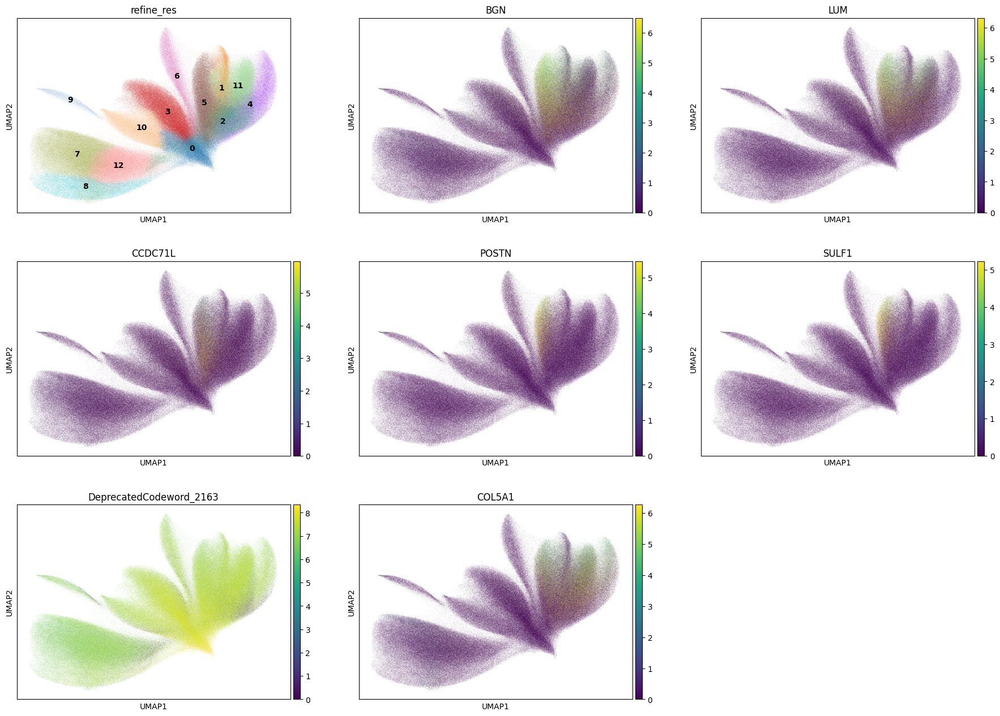

In [53]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [54]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 67961
Percentage of cells in cluster 5: 9.5


In [55]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.7. Cluster 6

In [56]:
cluster_id = '6'

In [57]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
42,6,Capillary EC,16
43,6,Arterial EC,5
44,6,Venous EC,5
45,6,Ovarian cancer specific LGR5 MUC16 epithelial ...,4
46,6,Naive CD4 T cell,4
47,6,Macrophage,4
48,6,Ovarian cancer enriched S100A9 MUC16 epithelia...,3


In [58]:
top_ranked_genes[cluster_id]

0       AQP1
1    SLCO2A1
2       FLT1
3      PTPRB
4      PLVAP
5        APP
6     PECAM1
Name: 6, dtype: object

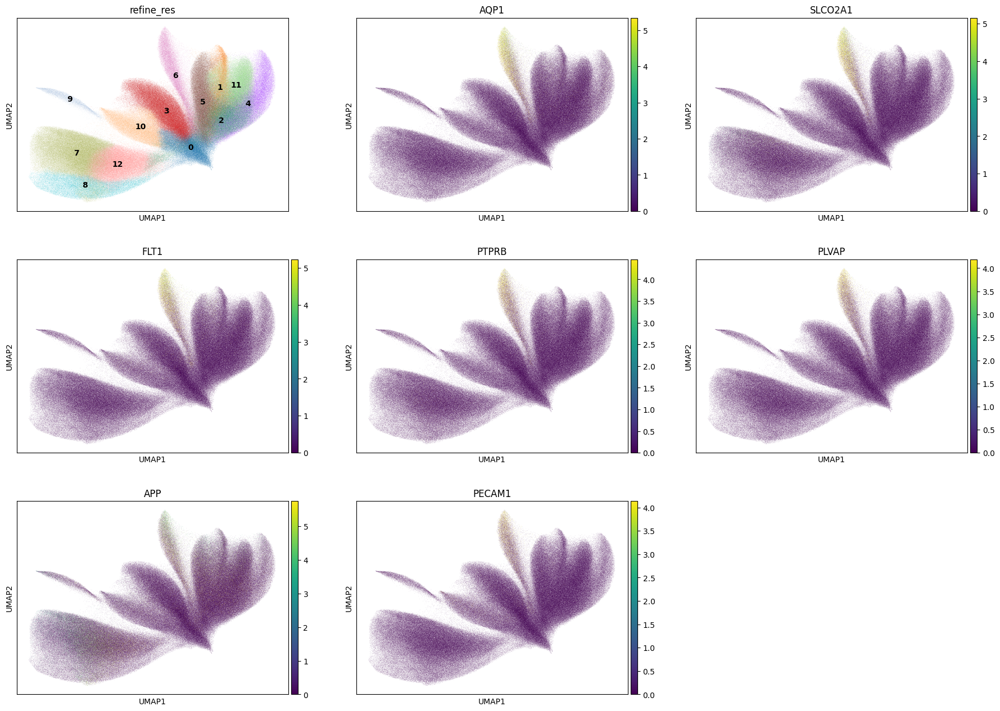

In [59]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [60]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 33174
Percentage of cells in cluster 6: 4.6


In [61]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.8. Cluster 7

In [62]:
cluster_id = '7'

In [63]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
49,7,Naive CD4 T cell,24
50,7,Ovarian cancer enriched S100A9 MUC16 epithelia...,15
51,7,CD56 NK,9
52,7,GZMK CD8 T,8
53,7,Macrophage,6
54,7,Ovarian cancer specific LGR5 MUC16 epithelial ...,4
55,7,Fibroblast,3


In [64]:
top_ranked_genes[cluster_id]

0      DSC3
1     HSPB1
2     H3F3B
3      LDHA
4      TNS4
5    TRIM29
6      DSG3
Name: 7, dtype: object

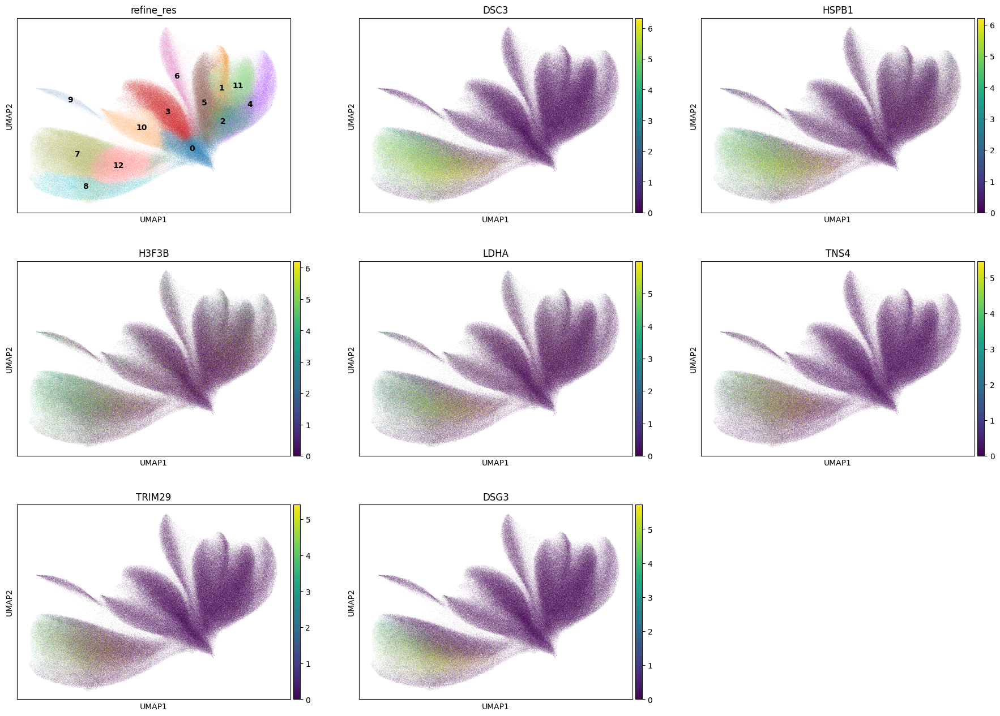

In [65]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [66]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 102133
Percentage of cells in cluster 7: 14.2


In [67]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Cancerous_cervical_epithelial_cell'

### 5.9. Cluster 8

In [68]:
cluster_id = '8'

In [69]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
56,8,Naive CD4 T cell,14
57,8,Ovarian cancer enriched S100A9 MUC16 epithelia...,13
58,8,CD56 NK,8
59,8,GZMK CD8 T,6
60,8,Macrophage,5
61,8,CD14 monocyte,4
62,8,Ovarian cancer specific LGR5 MUC16 epithelial ...,4


In [70]:
top_ranked_genes[cluster_id]

0      SPRR3
1       LCN2
2    CEACAM5
3     CDKN1A
4       EMP1
5       ECM1
6       MALL
Name: 8, dtype: object

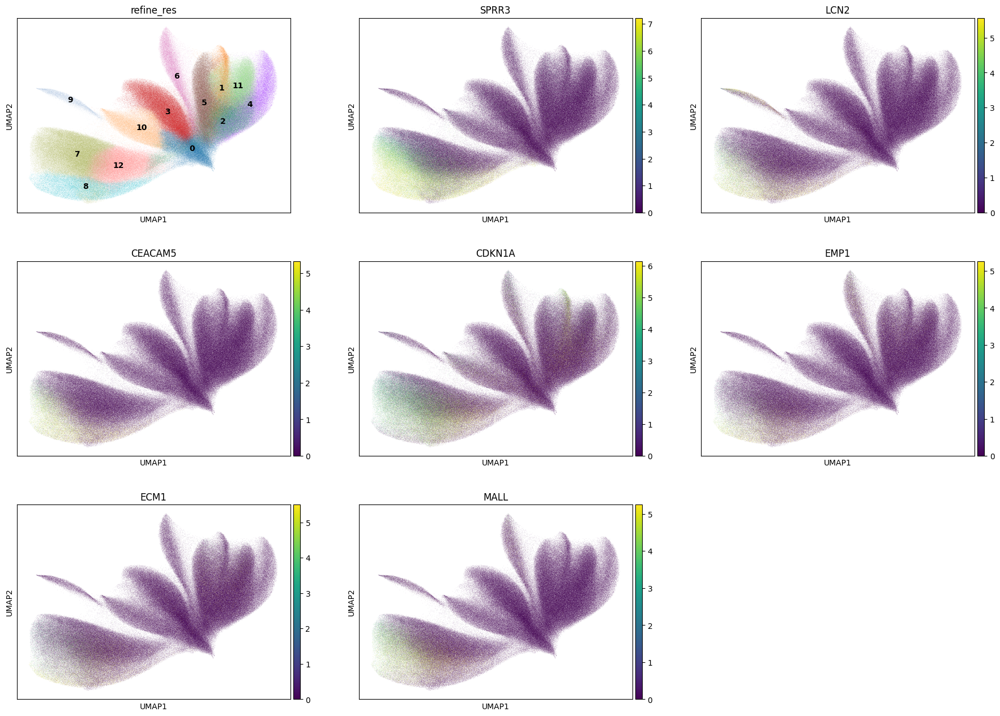

In [71]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [72]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 29004
Percentage of cells in cluster 8: 4.0


In [73]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Cancerous_cervical_epithelial_cell'

### 5.10. Cluster 9

In [74]:
cluster_id = '9'

In [75]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
63,9,Ovarian cancer enriched S100A9 MUC16 epithelia...,20
64,9,Ovarian cancer specific LGR5 MUC16 epithelial ...,15
65,9,Naive CD4 T cell,10
66,9,CD14 monocyte,5
67,9,Macrophage,4
68,9,CD56 NK,4
69,9,GZMK CD8 T,4


In [76]:
top_ranked_genes[cluster_id]

0       MUC5B
1        XBP1
2        AGR2
3      BPIFB1
4       THSD4
5    KIAA1324
6       PTGS2
Name: 9, dtype: object

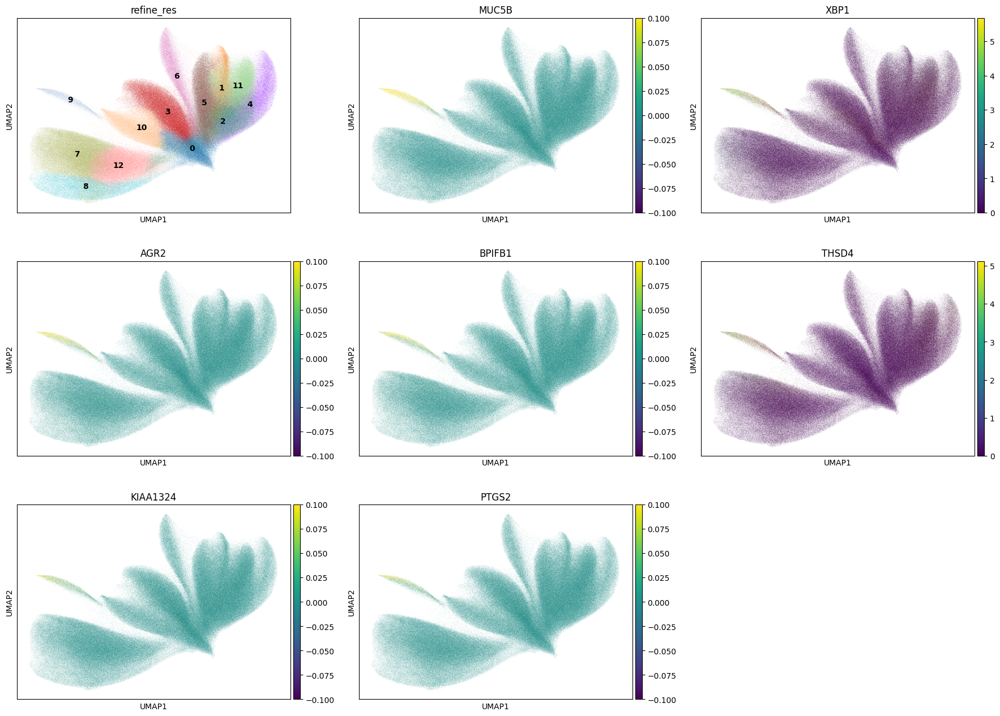

In [86]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [78]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 8814
Percentage of cells in cluster 9: 1.2


In [87]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Cancerous_cervical_epithelial_cell'

### 5.11. Cluster 10

In [88]:
cluster_id = '10'

In [89]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
70,10,Macrophage,29
71,10,CD14 monocyte,11
72,10,cDC2,6
73,10,MMP19 macrophage,4
74,10,Proliferation macrophage,4
75,10,CD56 NK,3
76,10,Naive CD4 T cell,3


In [90]:
top_ranked_genes[cluster_id]

0      C1QC
1    MS4A6A
2      AIF1
3    FCGR2A
4     CIITA
5    SLC2A3
6     STAB1
Name: 10, dtype: object

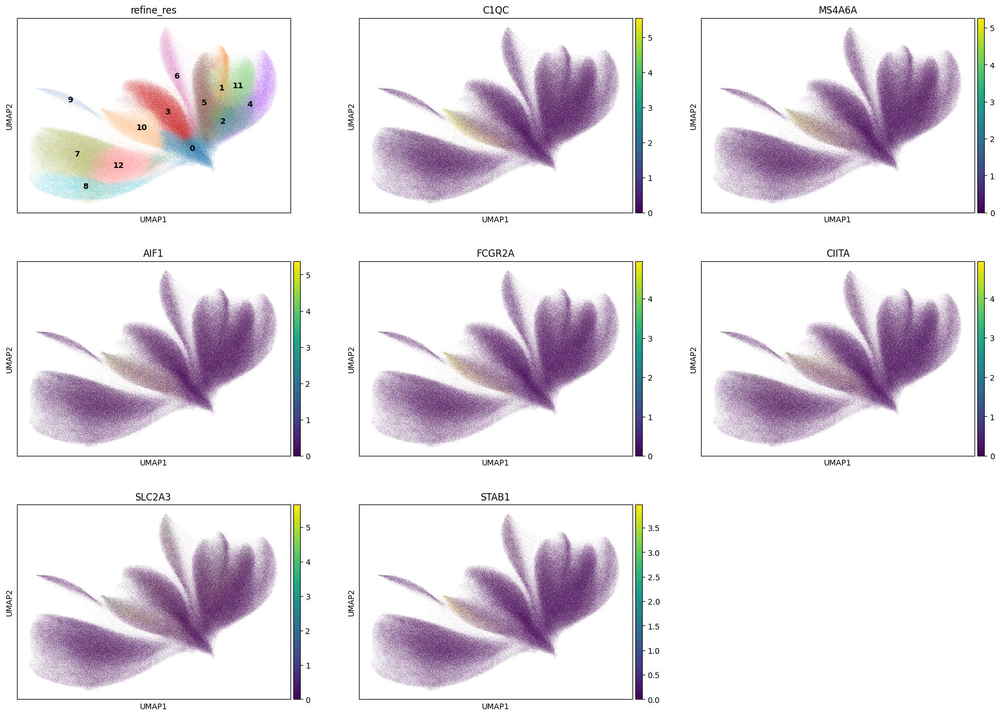

In [91]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [92]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 45433
Percentage of cells in cluster 10: 6.3


In [93]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage/DC'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage/DC'

### 5.12. Cluster 11

In [94]:
cluster_id = '11'

In [95]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
77,11,Fibroblast,10
78,11,CD56 NK,4
79,11,Macrophage,4
80,11,Ovarian cancer specific LGR5 MUC16 epithelial ...,4
81,11,Plasma cell,3
82,11,GZMK CD8 T,3
83,11,INF responsed CD8 T,3


In [96]:
top_ranked_genes[cluster_id]

0     PLPP3
1      MEG3
2     SFRP4
3    COL5A1
4     TIMP3
5       DCN
6     GREB1
Name: 11, dtype: object

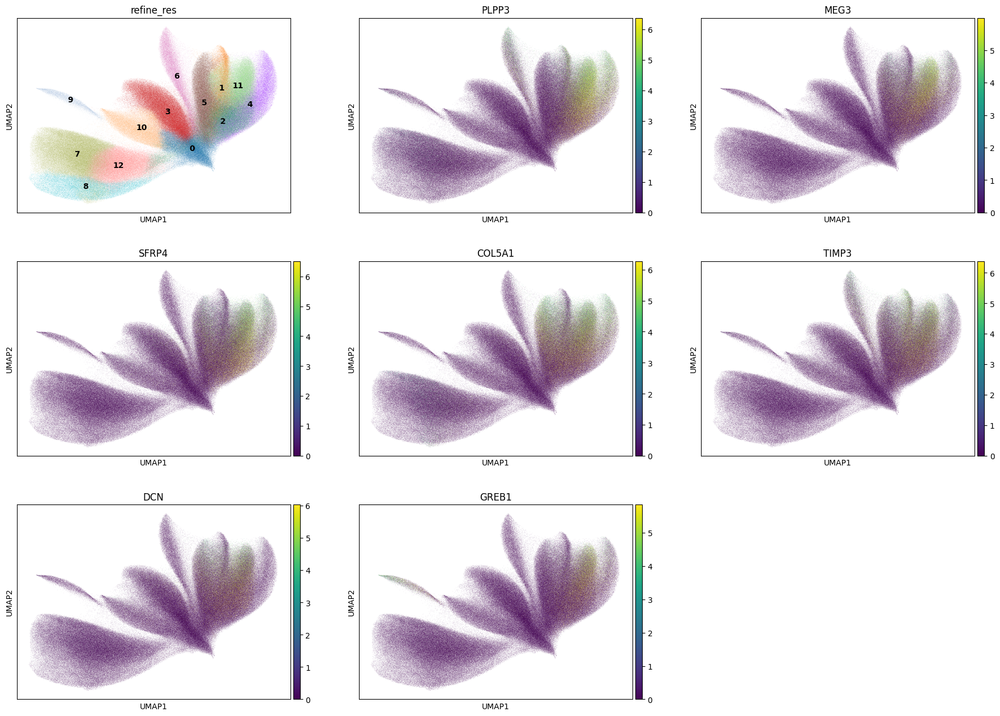

In [97]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [98]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 62903
Percentage of cells in cluster 11: 8.8


In [99]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.13. Cluster 12

In [100]:
cluster_id = '12'

In [101]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
84,12,INF responsed CD56 NK,5
85,12,Ovarian cancer specific LGR5 MUC16 epithelial ...,4
86,12,Ovarian cancer enriched S100A9 MUC16 epithelia...,4
87,12,Naive CD4 T cell,4
88,12,GZMK CD8 T,4
89,12,Proliferation macrophage,4
90,12,INF responsed CD8 T,4


In [102]:
top_ranked_genes[cluster_id]

0      DSC3
1     HSPB1
2     NDRG1
3      LDHA
4      DSG3
5    SLC2A1
6      TNS4
Name: 12, dtype: object

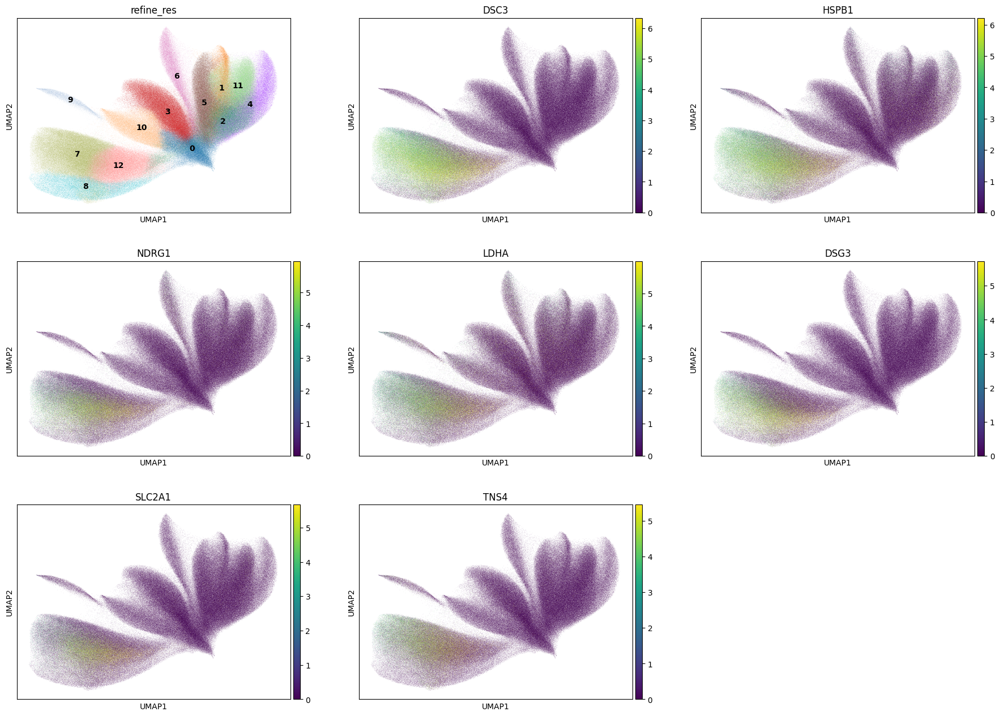

In [103]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [104]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 12: 74377
Percentage of cells in cluster 12: 10.4


In [105]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Cancerous_cervical_epithelial_cell'

## 6. Cancer cells

In [ ]:
adata.obs['label1'].unique()

In [ ]:
adata.obs['label2'].unique()

In [ ]:
# sc.pl.umap(adata, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [ ]:
# # Pathway analysis using KEGG pathways # https://www.genome.jp/brite/br08901

# s = KEGG()
# data = s.get("hsa05200")
# dict_data = s.parse(data)
# genes_cancer_ref = [info.split(';')[0] for info in dict_data['GENE'].values()]

# print(dict_data['NAME'])

In [249]:
# genes_cancer = list(set(adata.var_names.tolist()).intersection(genes_cancer_ref))

In [ ]:
# sc.pl.umap(adata, color=['label1', 'label2'] + genes_cancer, vmax="p99", vmin=0, ncols=4)

In [108]:
adata.obs['label2'].unique()

array(['Cancerous_cervical_epithelial_cell', 'Monocyte/Macrophage/DC',
       'T', 'Unknown', 'Fibroblast', 'Smooth_muscle', 'CAF',
       'Endothelial'], dtype=object)

In [109]:
# Cancer cells
adata.obs['label3'] = 'normal_cell'
adata.obs.loc[adata.obs['label2'].isin(['Cancerous_cervical_epithelial_cell']), 'label3'] = 'cancer_cell'

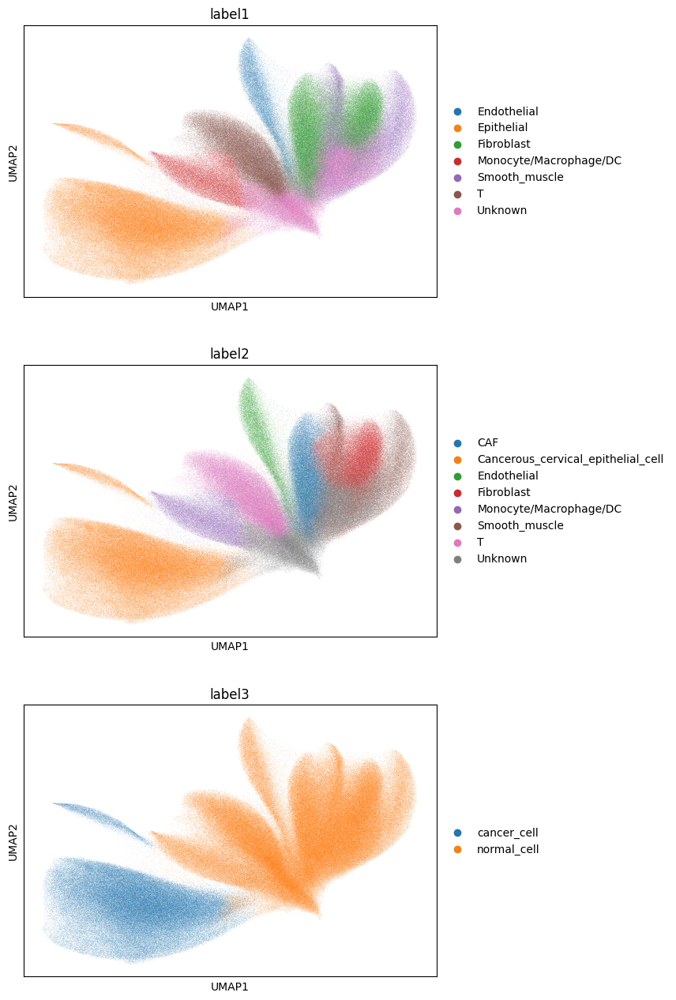

In [110]:
sc.pl.umap(adata, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [111]:
adata.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n20_pcs16_leiden_res0.2,pca_n20_pcs16_leiden_res0.4,pca_n20_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,50.213408,Plasma cell,119,3,7,9,9,Epithelial,Cancerous_cervical_epithelial_cell,cancer_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,14.382159,MMP19 macrophage,35,1,8,10,10,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,16.571872,CXCL13 exhausted CD8 T,54,1,8,10,10,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,36.304979,Naive CD4 T cell,120,3,7,9,9,Epithelial,Cancerous_cervical_epithelial_cell,cancer_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,25.152272,Ovarian cancer specific LGR5 MUC16 epithelial ...,104,3,7,9,9,Epithelial,Cancerous_cervical_epithelial_cell,cancer_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaamjjcj-1,nucleus_boundaries,morpho,aaamjjcj-1,19.055926,mregDC,18,0,2,2,2,Unknown,Unknown,normal_cell
aaamjjdb-1,nucleus_boundaries,morpho,aaamjjdb-1,9.798531,Proliferation EC,17,0,2,2,2,Unknown,Unknown,normal_cell
aaamjjdh-1,nucleus_boundaries,morpho,aaamjjdh-1,20.703898,B cell,15,1,8,10,10,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell
aaamjjdk-1,nucleus_boundaries,morpho,aaamjjdk-1,14.563144,Pericyte,22,1,8,0,0,Unknown,Unknown,normal_cell


In [112]:
adata.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
# adata = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")